[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1ma6uFr1NNMSYSqIwnrA1SjatendLpqlf)

# Laboratorio di Intelligenza Artificiale
## Anomaly Detection on MVTec AD

Progetto per l'esame di Laboratorio di Intelligenza Artificiale (A.A. 2019/20)

Andrea Bazerla - 151792

Taoufik Soudi - 124485

## Imports

In [ ]:
from google.colab import drive
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, Dense, ZeroPadding2D, Activation, InputLayer
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import Model
from keras.optimizers import Adam
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import cv2
import imgaug.augmenters as iaa
import time
from skimage.metrics import structural_similarity
from sklearn.metrics import f1_score
from keras.models import load_model

## Generic methods

In [ ]:
def get_timestamp() -> str:
  """
  Method that return timestamp as a string
  """

  return str(int(time.time()))

## Drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


## Paths
* Build images paths
* Copy sub-folder 'bottle' from Google Drive to Google Colab
* Convert BGR images to RGB through OpenCV
* Show sample images

Create drive path of object class 'bottle' that is inside the dataset

In [ ]:
drive_path = '/content/drive/My Drive/'
dataset_folder = 'mvtec_anomaly_detection/'
object_name = 'bottle'

dataset_path = drive_path + dataset_folder
object_path = dataset_path + object_name + '/'

Copy 'bottle' class folder from Google Drive to Google Colab filesystem to incrase performance in training.

In [ ]:
!cp -r '$object_path' '/content/'

Create local paths of object class 'bottle'

In [ ]:
img_name = '000'
extension = '.png'

# Train paths
train_path = object_path + 'train/'
train_good_path = train_path + 'good/'

# Test paths
test_path = object_path + 'test/'
test_good_path = test_path + 'good/'
test_broken_large_path = test_path + 'broken_large/'
test_broken_small_path = test_path + 'broken_small/'
test_contamination_path = test_path + 'contamination/'

# Ground Truth paths
ground_truth_path = object_path + 'ground_truth/'
ground_truth_broken_small_path = ground_truth_path + 'broken_small/'
ground_truth_broken_large_path = ground_truth_path + 'broken_large/'
ground_truth_contamination_path = ground_truth_path + 'contamination/'

Creating sample images of train, test and ground truth folders throught OpenCV library

In [ ]:
# Train image
img_train_good = cv2.imread(train_good_path + img_name + extension)

# Test images
img_test_good = cv2.imread(test_good_path + img_name + extension)
img_test_broken_large = cv2.imread(test_broken_large_path + img_name + extension)
img_test_broken_small = cv2.imread(test_broken_small_path + img_name + extension)
img_test_contamination = cv2.imread(test_contamination_path + img_name + extension)

# Grund Truth images
img_ground_truth_broken_small = cv2.imread(ground_truth_broken_small_path + img_name + '_mask' + extension)
img_ground_truth_broken_large = cv2.imread(ground_truth_broken_large_path + img_name + '_mask' + extension)
img_ground_truth_contamination = cv2.imread(ground_truth_contamination_path + img_name + '_mask' + extension)

Normalize images converting them from BGR to RGB

In [ ]:
img_rgb_train_good = cv2.cvtColor(img_train_good, cv2.COLOR_BGR2RGB)

img_rgb_test_good = cv2.cvtColor(img_test_good, cv2.COLOR_BGR2RGB)
img_rgb_test_broken_large = cv2.cvtColor(img_test_broken_large, cv2.COLOR_BGR2RGB)
img_rgb_test_broken_small = cv2.cvtColor(img_test_broken_small, cv2.COLOR_BGR2RGB)
img_rgb_test_contamination = cv2.cvtColor(img_test_contamination, cv2.COLOR_BGR2RGB)

img_rgb_ground_truth_broken_small = cv2.cvtColor(img_ground_truth_broken_small, cv2.COLOR_BGR2RGB)
img_rgb_ground_truth_broken_large = cv2.cvtColor(img_ground_truth_broken_large, cv2.COLOR_BGR2RGB)
img_rgb_ground_truth_contamination = cv2.cvtColor(img_ground_truth_contamination, cv2.COLOR_BGR2RGB)

Print sample images

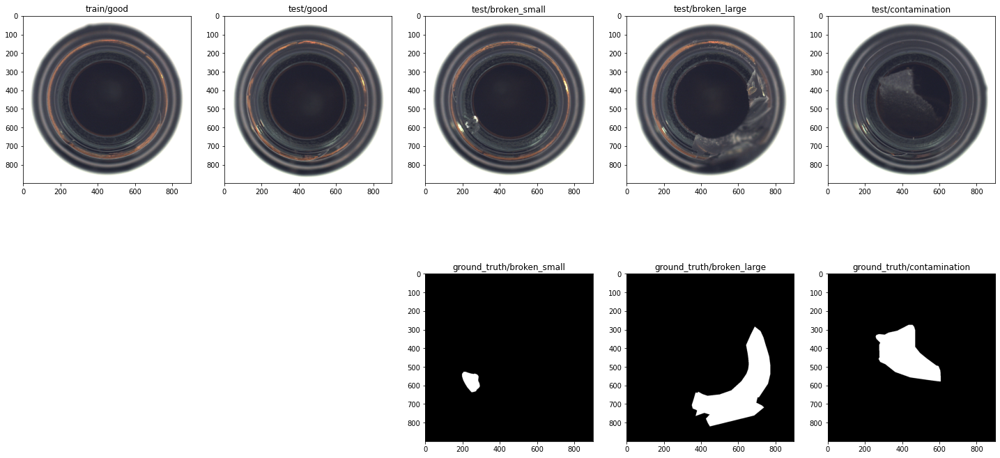

In [ ]:
figure = plt.figure(figsize=(25, 25))

train_good_subplot = figure.add_subplot(1, 5, 1)
train_good_subplot.set_title("train/good")
plt.imshow(img_rgb_train_good)

train_good_subplot = figure.add_subplot(1, 5, 2)
train_good_subplot.set_title("test/good")
plt.imshow(img_rgb_test_good)

train_good_subplot = figure.add_subplot(1, 5, 3)
train_good_subplot.set_title("test/broken_small")
plt.imshow(img_rgb_test_broken_small)

train_good_subplot = figure.add_subplot(1, 5, 4)
train_good_subplot.set_title("test/broken_large")
plt.imshow(img_rgb_test_broken_large)

train_good_subplot = figure.add_subplot(1, 5, 5)
train_good_subplot.set_title("test/contamination")
plt.imshow(img_rgb_test_contamination)

train_good_subplot = figure.add_subplot(2, 5, 8)
train_good_subplot.set_title("ground_truth/broken_small")
plt.imshow(img_ground_truth_broken_small)

train_good_subplot = figure.add_subplot(2, 5, 9)
train_good_subplot.set_title("ground_truth/broken_large")
plt.imshow(img_ground_truth_broken_large)

train_good_subplot = figure.add_subplot(2, 5, 10)
train_good_subplot.set_title("ground_truth/contamination")
plt.imshow(img_ground_truth_contamination)

## Pre-processing

* Load images from local file
* Resize images to 227 x 227 pixels
* Change color images to grayscale
* Normalize (0-225) images to (0-1) for efficient training

To improve the performance and efficiency of the training, we converted colored image with pixel values between 0 and 255 in grayscale firstly, thus from RGB with 3 channels to 1 channel. Then we reduced the range of values between 0 and 1.

In [ ]:
img_height, img_width, img_channels = 227, 227, 1

In [ ]:
# Array of train good images name
train_set = os.listdir(train_good_path)

# Array of testing folder
test_folders = os.listdir(test_path)

# Array of ground truth images
# (Copy of test folders name without good sub-folder to get them in the same order)
ground_truth_folders = test_folders.copy()
ground_truth_folders.remove('good')

In [ ]:
print('Training Set: \t\t' + ', '.join(train_set))
print('Testing Folders: \t' + ', '.join(test_folders))
print('Ground Thruth Folders: \t' + ', '.join(ground_truth_folders))

Training Set: 		002.png, 017.png, 008.png, 023.png, 025.png, 001.png, 038.png, 000.png, 036.png, 037.png, 029.png, 027.png, 020.png, 030.png, 010.png, 026.png, 034.png, 015.png, 021.png, 032.png, 028.png, 018.png, 007.png, 012.png, 014.png, 003.png, 031.png, 011.png, 019.png, 004.png, 033.png, 013.png, 005.png, 006.png, 024.png, 022.png, 009.png, 016.png, 035.png, 100.png, 040.png, 039.png, 139.png, 138.png, 165.png, 140.png, 071.png, 061.png, 130.png, 119.png, 078.png, 059.png, 137.png, 073.png, 044.png, 046.png, 124.png, 167.png, 072.png, 162.png, 090.png, 123.png, 131.png, 160.png, 142.png, 064.png, 101.png, 170.png, 092.png, 077.png, 121.png, 108.png, 095.png, 120.png, 102.png, 129.png, 050.png, 103.png, 133.png, 104.png, 088.png, 074.png, 161.png, 080.png, 051.png, 145.png, 099.png, 087.png, 041.png, 063.png, 116.png, 157.png, 128.png, 076.png, 054.png, 114.png, 158.png, 105.png, 097.png, 069.png, 079.png, 127.png, 107.png, 109.png, 106.png, 060.png, 125.png, 135.png, 155.png, 057

Load images from their paths to store them in arrays

* `X_color`: good images of training set
* `y_god_color`: good images of testing set
* `y_bad_color`: bad images of testing set
* `ground_truth`: masks of bad images of testing set

In [ ]:
X_color, y_good_color, y_bad_color, ground_truth = [], [], [], []

# Loop over images of sub-folder good of training set
for img_id in train_set:
  img_path = train_good_path + img_id
  img = cv2.imread(img_path)
  img = cv2.resize(img, (img_height, img_width))
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  X_color.append(img)

# Loop over testing folders
for test_folder in test_folders:
  test_folder_path = test_path + test_folder

  # Loop over testing set images
  for img_id in sorted(os.listdir(test_folder_path)):
    img = cv2.imread(test_folder_path + '/' + img_id)
    img = cv2.resize(img, (img_height, img_width))

    if test_folder == 'good':
      y_good_color.append(img)
    else:
      y_bad_color.append(img)

# Loop over ground thruth folders
for ground_truth_folder in ground_truth_folders:
  ground_truth_folder_path = ground_truth_path + ground_truth_folder
  
  # Loop over gound thruth images
  for img_id in sorted(os.listdir(ground_truth_folder_path)):
    img = cv2.imread(ground_truth_folder_path + '/' + img_id)
    img = cv2.resize(img, (img_height, img_width))
    ground_truth.append(img)

# Convert images loaded to arrays
X_color = np.asarray(X_color)
y_good_color = np.asarray(y_good_color)
y_bad_color = np.asarray(y_bad_color)
ground_truth = np.asarray(ground_truth)

# Print set shapes
print("Training: \t\t", np.shape(X_color))
print("Good Testing: \t\t", np.shape(y_good_color))
print("Anomalous Testing: \t", np.shape(y_bad_color))
print("Groud Truth: \t\t", np.shape(ground_truth))

Training: 		 (209, 227, 227, 3)
Good Testing: 		 (20, 227, 227, 3)
Anomalous Testing: 	 (63, 227, 227, 3)
Groud Truth: 		 (63, 227, 227, 3)


In [ ]:
print('X_color[0]')
print(X_color[0])

print('\ny_good_color[0]')
print(y_good_color[0])

print('\ny_bad_color[0]')
print(y_bad_color[0])

print('\nground_truth[0]')
print(ground_truth[0])

X_color[0]
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]]

y_good_color[0]
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 2

In [ ]:
def to_grayscale(imgs):
  """
  Method to convert images in grayscale
  """

  # Put the last dimension of the images from 3 to 0
  imgs_gray = np.zeros(imgs.shape[:-1])

  # Convert images in grayscale
  for i in range(len(imgs)): 
    imgs_gray[i] = cv2.cvtColor(imgs[i], cv2.COLOR_BGR2GRAY)

  # Increment array with one dimension
  imgs_gray = imgs_gray[:, :, :, np.newaxis]
  
  return imgs_gray

In [ ]:
# Convert images to array
X_color_array = np.asarray(X_color)
y_good_color_array = np.asarray(y_good_color)
y_bad_color_array = np.asarray(y_bad_color)
ground_truth_array = np.asarray(ground_truth)

# Convert RGB images to grayscale
X_grayscale = to_grayscale(X_color_array.astype('uint8'))
y_good_grayscale = to_grayscale(y_good_color_array.astype('uint8'))
y_bad_grayscale = to_grayscale(y_bad_color_array.astype('uint8'))

# Normalize pixel from 0~255 values to 0~1 range 
X_normalize = X_grayscale.astype('float32') / 255.0 
y_good_normalize = y_good_grayscale.astype('float32') / 255.0 
y_bad_normalize = y_bad_grayscale.astype('float32') / 255.0 

Display RGB, grayscale and normalized image.

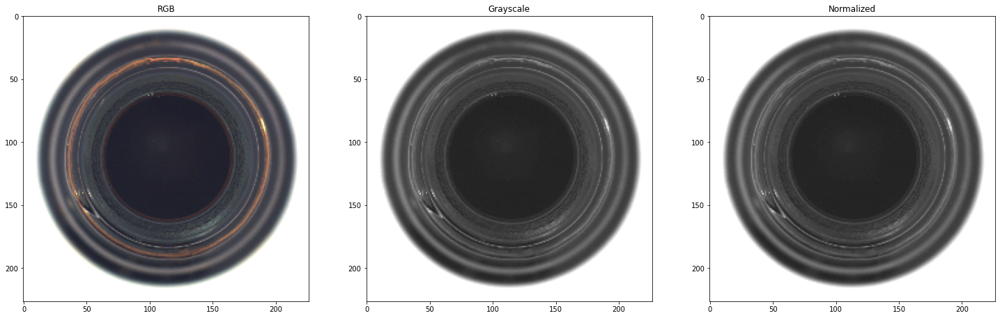

In [ ]:
img_color = X_color_array[0]
img_grayscale = X_grayscale[0]
img_normalize = X_normalize[0]

figure = plt.figure(figsize=(25, 25))

# RGB
subplot1 = figure.add_subplot(1, 3, 1)
subplot1.set_title("RGB")
plt.imshow(img_color)

# Grayscale
subplot2 = figure.add_subplot(1, 3, 2)
subplot2.set_title("Grayscale")
plt.imshow(img_grayscale.squeeze(), cmap="gray", vmin=0, vmax=255)

# Normalized
subplot3 = figure.add_subplot(1, 3, 3)
subplot3.set_title("Normalized")
plt.imshow(img_normalize.squeeze(), cmap="gray", vmin=0, vmax=1)

## Architecture

Architecture of AlexNet for the Convolutional Autoencoder

In [ ]:
model = Sequential()

# Encoder

model.add(InputLayer(input_shape=(img_height, img_width, img_channels)))

model.add(Conv2D(filters=96, kernel_size=(11, 11), strides=(4, 4), padding='valid'))
model.add(Activation('relu'))

model.add(MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))

model.add(ZeroPadding2D(padding=(2, 2)))

model.add(Conv2D(filters=256, kernel_size=(5, 5), strides=(1, 1), padding='valid'))
model.add(Activation('relu'))

model.add(MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2D(filters=384, kernel_size=(3, 3), strides=(1, 1), padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2D(filters=384, kernel_size=(3, 3), strides=(1, 1), padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1), padding='valid'))
model.add(Activation('relu'))

model.add(MaxPooling2D(pool_size=(3, 3), strides=(2, 2)))

# Bottleneck

model.add(Dense(2048))
model.add(Activation('relu'))

# Decoder

model.add(Conv2DTranspose(256, (3, 3), strides=2))
model.add(Conv2D(256, (3, 3), strides=1, padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2D(384, (3, 3), strides=1, padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2D(384, (3, 3), strides=1, padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(1, 1)))

model.add(Conv2DTranspose(256, (3, 3), strides=2))

model.add(Conv2D(256, (5, 5), strides=1, padding='valid'))
model.add(Activation('relu'))

model.add(ZeroPadding2D(padding=(2, 2)))

model.add(Conv2DTranspose(96, (3, 3), strides=2))
model.add(Activation('relu'))

model.add(Conv2DTranspose(96, (11, 11), strides=4))

model.add(Conv2D(96, (11, 11), strides=4, padding='valid'))
model.add(Activation('relu'))

model.add(Conv2DTranspose(96, (11, 11), strides=4))

model.add(Conv2D(1, (1, 1)))
model.add(Activation('sigmoid'))

## SSIM

**Structural Similarity Index (SSIM)** is used as a metric to measure the similarity between two given images.

In [ ]:
def SSIMLoss(y_true, y_pred):
  """
  SSIM Loss function that take as input the true image, its recustruction and a max value
  If two images are identical: 1-1=0
  If two images are completely different: 1-0=1
  """

  return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

In [ ]:
optimizer = Adam(learning_rate=1e-4)

In [ ]:
model.compile(optimizer=optimizer, loss=SSIMLoss)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 55, 55, 96)        11712     
_________________________________________________________________
activation (Activation)      (None, 55, 55, 96)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 27, 27, 96)        0         
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 31, 31, 96)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 27, 27, 256)       614656    
_________________________________________________________________
activation_1 (Activation)    (None, 27, 27, 256)       0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 13, 13, 256)       0

## Data Augmentation 

`X_normalize`: training images RGB converted in grayscale and then normalized

In [ ]:
# Horizontal flipping
hflip = iaa.Fliplr(1)
hflip_aug = hflip(images=X_normalize)

# Vertical flipping
vflip = iaa.Flipud(1)
vflip_aug = vflip(images=X_normalize)

# Concatenate Augmented data to Training Set
X_aug = np.concatenate((X_normalize, hflip_aug, vflip_aug)) 
np.random.shuffle(X_aug)

print('Augmented Training Set:', X_aug.shape)

Augmented Training Set: (627, 227, 227, 1)


## Training

In [ ]:
# Get timestamp number
timestamp = get_timestamp()

In [ ]:
# Callbacks for every epoch: EarlyStopping with patience euqual to 10 and ModelCheckpoint to save the best model.
callbacks = [
  EarlyStopping(patience = 10, monitor = 'val_loss'),
  ModelCheckpoint('model_' + object_name + '_' + timestamp + '.h5', verbose=1, save_best_only = True)
]

In [ ]:
# Start to fit the model saving results between each epoch in history variable ready to be plotted at the end of training
history = model.fit(X_aug, X_aug, validation_split=0.05, batch_size=8, epochs=150, callbacks=callbacks)

Epoch 1/150
75/75 [==============================] - 69s 262ms/step - loss: 0.5766 - val_loss: 0.4754

Epoch 00001: val_loss improved from inf to 0.47544, saving model to model_bottle_1626637338.h5
Epoch 2/150
75/75 [==============================] - 17s 229ms/step - loss: 0.4484 - val_loss: 0.3332

Epoch 00002: val_loss improved from 0.47544 to 0.33324, saving model to model_bottle_1626637338.h5
Epoch 3/150
75/75 [==============================] - 18s 238ms/step - loss: 0.2874 - val_loss: 0.2351

Epoch 00003: val_loss improved from 0.33324 to 0.23506, saving model to model_bottle_1626637338.h5
Epoch 4/150
75/75 [==============================] - 18s 246ms/step - loss: 0.2166 - val_loss: 0.2120

Epoch 00004: val_loss improved from 0.23506 to 0.21202, saving model to model_bottle_1626637338.h5
Epoch 5/150
75/75 [==============================] - 19s 251ms/step - loss: 0.2055 - val_loss: 0.2132

Epoch 00005: val_loss did not improve from 0.21202
Epoch 6/150
75/75 [=======================

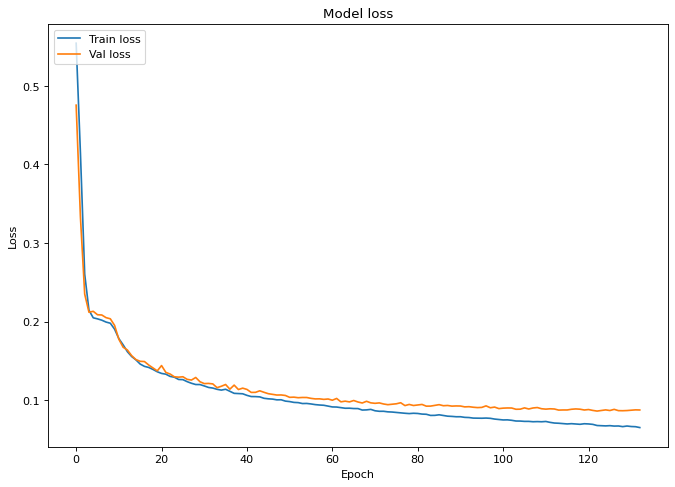

In [ ]:
figure(figsize=(10, 7))

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

plt.title('Model loss')

plt.ylabel('Loss')
plt.xlabel('Epoch')

plt.legend(['Train loss', 'Val loss'], loc='upper left')

plt.show()

## Prediction

Load the model previously fitted and saved.

In [ ]:
# Create name and path of model to load it from Google Drive
timestamp = '1626611345'
model_name = 'model_' + object_name + '_' + timestamp + '.h5'
model_path = drive_path + model_name

In [ ]:
# Copy model from Google Drive to Google Colab
!cp -r '$model_path' '/content/'

In [ ]:
# Load the model previously fitted and saved
model = load_model(model_name, compile=False)

Split the test datasets to validation and testing sets to find the best threshold to divide good objects from anomaly object



In [ ]:
# Shuffle good testing images
np.random.shuffle(y_good_normalize)

# Pair test anomaly images with their corrisponding ground_truth and then shuffle them
y_bad_ground_truth = list(zip(y_bad_normalize, ground_truth_array))
np.random.shuffle(y_bad_ground_truth)

y_bad_normalize, ground_truth_array = zip(*y_bad_ground_truth)

# Convert them to arrays
y_bad_normalize, ground_truth_array = np.asarray(y_bad_normalize), np.asarray(ground_truth_array)

# Creating Validation Set (30%)
y_good_valid = y_good_normalize[:int(len(y_good_normalize)*0.3)]
y_bad_valid = y_bad_normalize[:int(len(y_bad_normalize)*0.3)]
ground_truth_valid = ground_truth_array[:int(len(y_bad_normalize)*0.3)]

# Creating Testing Set (70%)
y_good_test = y_good_normalize[int(len(y_good_normalize)*0.3):]
y_bad_test = y_bad_normalize[int(len(y_bad_normalize)*0.3):]
ground_truth_test = ground_truth_array[int(len(y_bad_normalize)*0.3):]

Predict training, validation and testing anomaly and anomaly-free respectively images through our model

* `preds_train`: predicted reconstructions of traning images
* `preds_valid_good`: predicted reconstructions of anomaly-free validation images
* `preds_valid_bad`: predicted reconstructions of anomalous validation images
* `preds_test_good`: predicted reconstructions of non-anomalous test images
* `preds_test_bad`: predicted reconstructions of anomalous test images

In [ ]:
preds_train = model.predict(X_normalize, verbose=1)

preds_valid_good = model.predict(y_good_valid, verbose=1)
preds_valid_bad = model.predict(y_bad_valid, verbose=1)

preds_test_good = model.predict(y_good_test, verbose=1)
preds_test_bad = model.predict(y_bad_test, verbose=1)

2/2 [==============================] - 4s 4s/step


## Validation

Support functions to display images, generate score and normalize values

In [ ]:
def print_two_imgs(img_left, img_right, label_left='', label_right=''):
  """
  Method to print two images side by side
  """

  figure = plt.figure(figsize=(10, 10))
  
  figure_left = figure.add_subplot(1, 2, 1)
  figure_left.set_title(label_left)
  
  plt.imshow(img_left.reshape(img_height, img_width), cmap='gray', vmin=0, vmax=1)

  figure_right = figure.add_subplot(1, 2, 2)
  figure_right.set_title(label_right)
  
  plt.imshow(img_right.reshape(img_height, img_width), cmap='gray', vmin=0, vmax=1)

def generate_score_and_ground_truth_ssim(original, reconstructed):
  """
  Method to generate SSIM score and SSIM difference image
  """

  # Compute the arithmetic mean along the last axis
  original = np.mean(original, axis=-1)
  reconstructed = np.mean(reconstructed, axis=-1)

  # With full=True return SSIM image too
  (ssim_score, ssim_img) = structural_similarity(original, reconstructed, full=True)
  
  return 1-ssim_score, 1-ssim_img

def generate_score_and_ground_truth_l2(original, reconstructed):
  """
  Method to generate L2 score and L2 difference image
  """

  original = np.mean(original, axis=-1)
  reconstructed = np.mean(reconstructed, axis=-1)
  
  L2_img = (original-reconstructed)**2
  L2_score = np.mean(L2_img)
  
  return L2_score, L2_img

def compare_img_and_ground_truth(original, reconstructed, ssim_img, l2_img, ground_truth = None):
  """
  Method to display original, recontructed, SSIM image, L2 image and ground truth image
  """

  figure = plt.figure(figsize=(25, 25))

  # Original image
  ori = figure.add_subplot(1, 5, 1)
  ori.set_title("Original")
  original = original.squeeze()
  plt.imshow(np.stack((original, original, original), axis = 2))

  # Reconstructed image
  recon = figure.add_subplot(1, 5, 2)
  recon.set_title("Reconstructed")
  reconstructed = reconstructed.squeeze()
  plt.imshow(np.stack((reconstructed, reconstructed, reconstructed), axis = 2))

  # Ground truth image
  if ground_truth is not None:
    ground_truth_figure = figure.add_subplot(1, 5, 3)
    ground_truth_figure.set_title("Ground Truth")
    plt.imshow(ground_truth) 

  # SSIM difference image
  ssim_diff = figure.add_subplot(1, 5, 4)
  ssim_diff.set_title("SSIM img")
  plt.imshow(ssim_img)

  # L2 difference image
  l2_diff = figure.add_subplot(1, 5, 5)
  l2_diff.set_title("L2 img")
  plt.imshow(l2_img)

  plt.tight_layout()

def normalize(data1, data2):
  """
  Method that jointly normalizes data1 and data2 to range of 0-1
  """

  # Get min and max value respectively of data1 and data2
  global_min = min(min(data1), min(data2))
  global_max = max(max(data1), max(data2))

  return (data1 - global_min) / (global_max - global_min), (data2 - global_min) / (global_max - global_min)

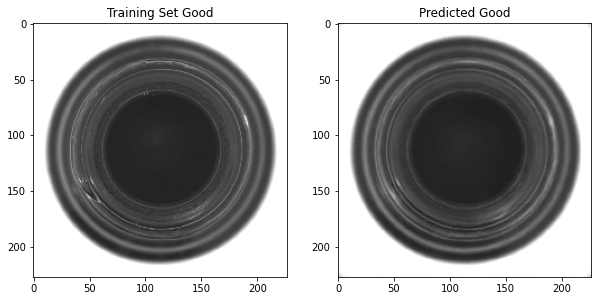

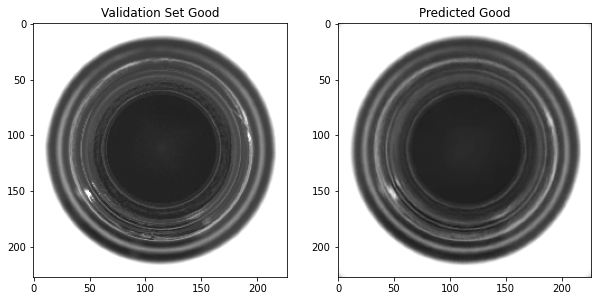

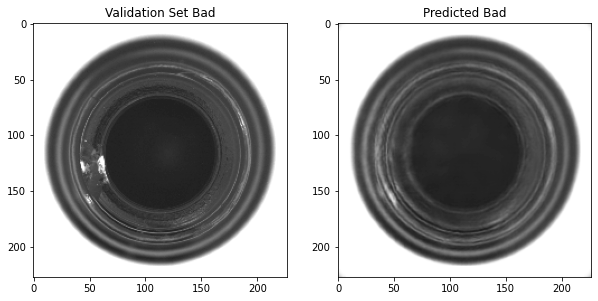

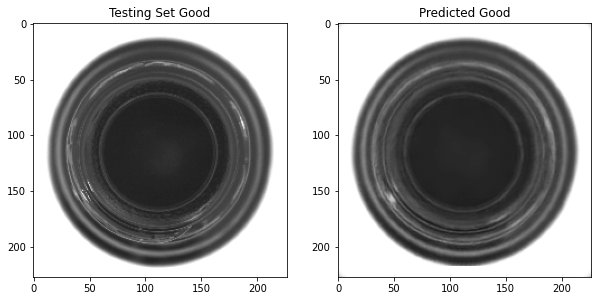

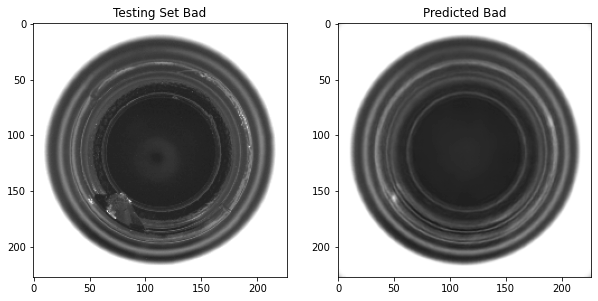

In [ ]:
# Compare original and reconstucted sample images in training set
print_two_imgs(X_normalize[0], preds_train[0], 'Training Set Good', 'Predicted Good')
print_two_imgs(y_good_valid[0], preds_valid_good[0], 'Validation Set Good', 'Predicted Good')
print_two_imgs(y_bad_valid[0], preds_valid_bad[0], 'Validation Set Bad', 'Predicted Bad')
print_two_imgs(y_good_test[0], preds_test_good[0], 'Testing Set Good', 'Predicted Good')
print_two_imgs(y_bad_test[0], preds_test_bad[0], 'Testing Set Bad', 'Predicted Bad')

**Validation Set (Anomalous)**

Collect SSIM and L2 scores of anomalous validation set

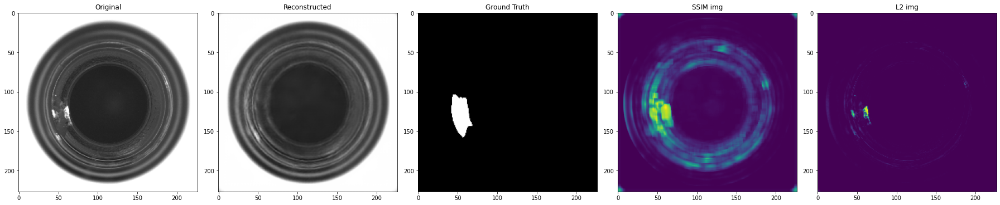

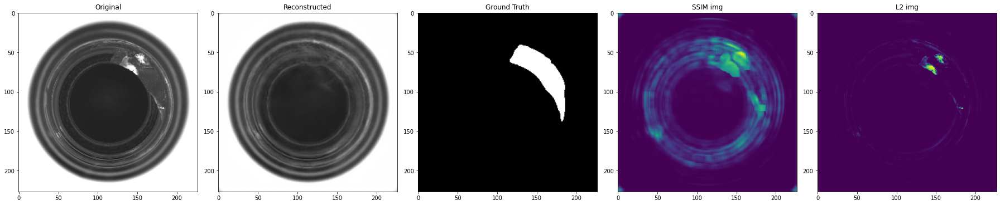

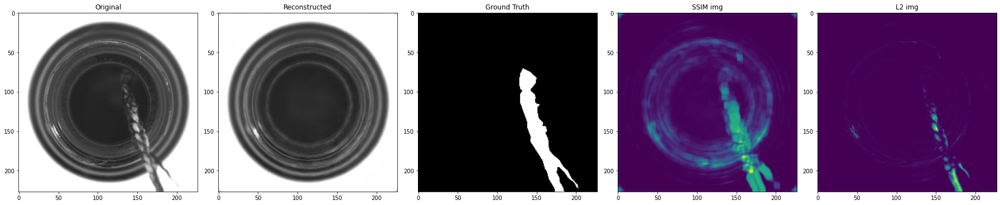

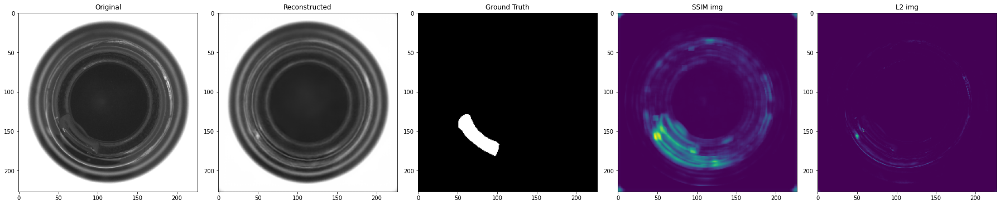

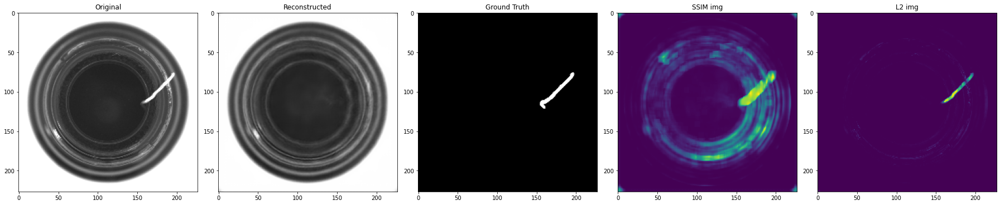

...

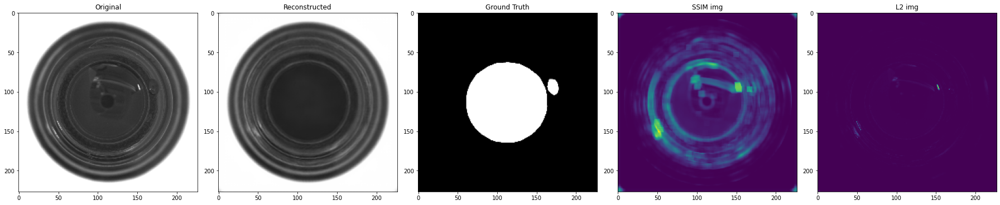

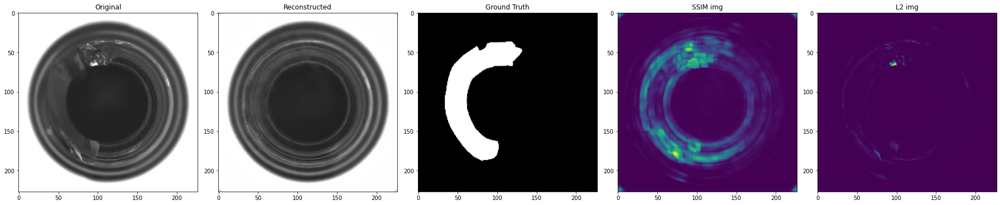

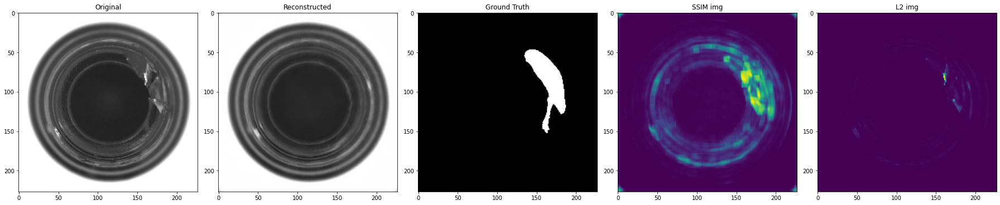

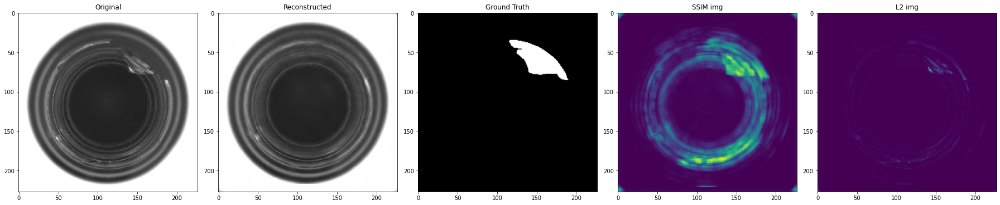

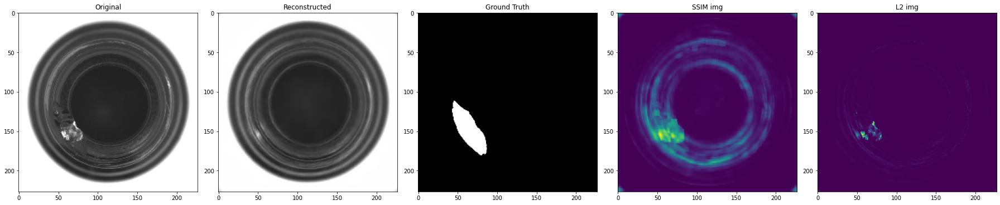

In [ ]:
bad_valid_l2_scores = []
bad_valid_ssim_scores = []

# Loop over validation set of anomaly images
for i in range(len(y_bad_valid)):
  original = y_bad_valid[i]
  reconstructed = preds_valid_bad[i]

  # Generate score and difference images
  ssim_score, ssim_diff = generate_score_and_ground_truth_ssim(original, reconstructed)
  l2_score, l2_diff = generate_score_and_ground_truth_l2(original, reconstructed)

  bad_valid_ssim_scores.append(ssim_score)
  bad_valid_l2_scores.append(l2_score)

  compare_img_and_ground_truth(original, reconstructed, ssim_diff, l2_diff, ground_truth_valid[i])

**Validation Set (Non-Anomalous)**

Collect SSIM and L2 scores of anomaly-free validation set

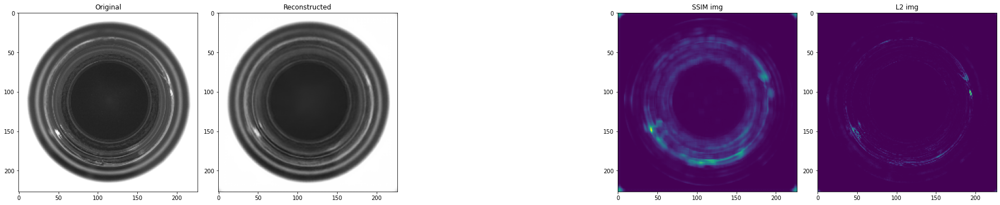

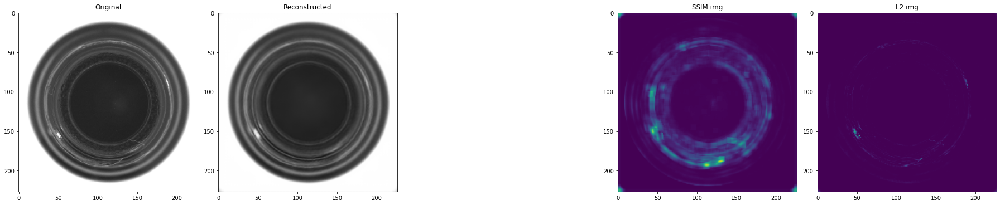

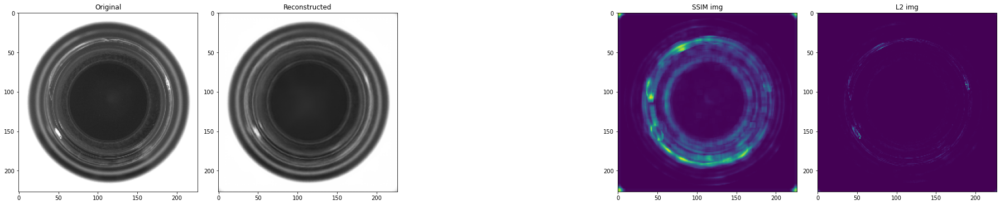

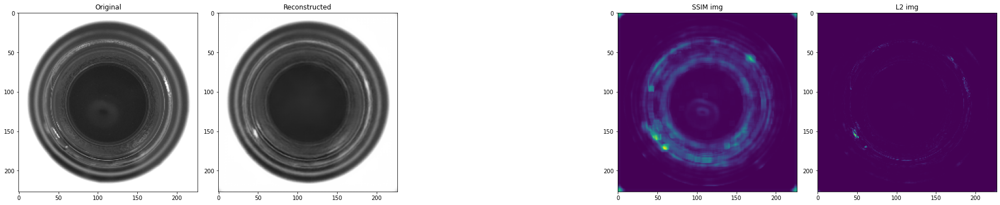

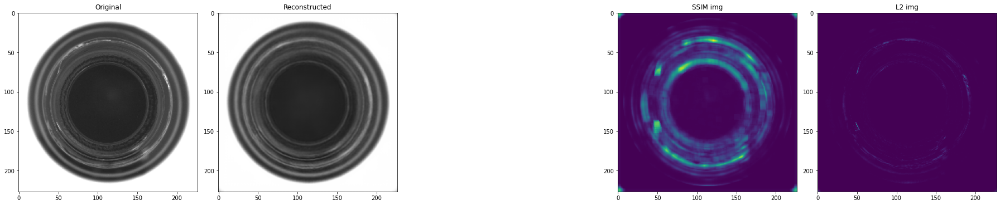

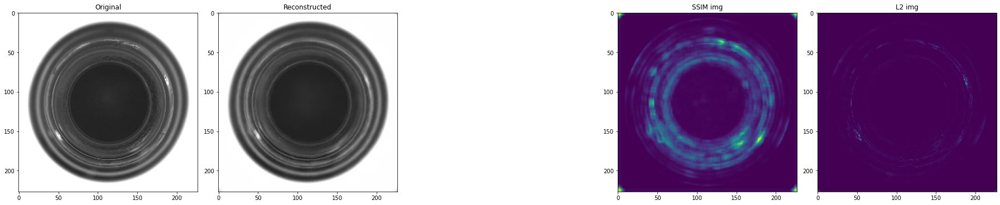

In [ ]:
good_valid_l2_scores = []
good_valid_ssim_scores = []

# Loop over validation set of anomaly images
for i in range(len(y_good_valid)):
  original = y_good_valid[i]
  reconstructed = preds_valid_good[i]

  # Generate score and difference images
  ssim_score, ssim_diff = generate_score_and_ground_truth_ssim(original, reconstructed)
  l2_score, l2_diff = generate_score_and_ground_truth_l2(original, reconstructed)

  good_valid_ssim_scores.append(ssim_score)
  good_valid_l2_scores.append(l2_score)

  compare_img_and_ground_truth(original, reconstructed, ssim_diff, l2_diff, None)

Normalize SSIM and L2 scores

In [ ]:
good_valid_ssim_scores_norm, bad_valid_ssim_scores_norm = normalize(good_valid_ssim_scores, bad_valid_ssim_scores)
good_valid_l2_scores_norm, bad_valid_l2_scores_norm = normalize(good_valid_l2_scores, bad_valid_l2_scores)

Scatter plots of SSIM and L2 reconstruction difference scores of anomalous and non-anomalous validation images

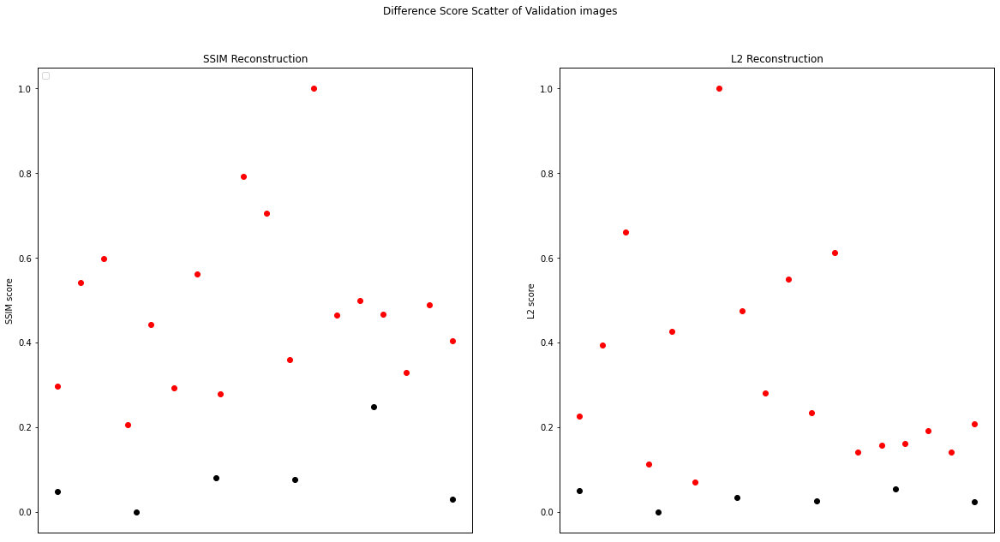

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
fig.suptitle('Difference Score of Validation images')

ax[0].set_title('SSIM Reconstruction')
ax[0].set_ylabel('SSIM score')
ax[0].legend(['Train loss', 'Val loss'], loc='upper left')
ax[0].scatter(range(1, len(bad_valid_ssim_scores_norm) + 1), bad_valid_ssim_scores_norm, c='red')
ax0 = ax[0].twiny()
ax0.scatter(range(1, len(good_valid_ssim_scores_norm) + 1), good_valid_ssim_scores_norm, c='black')
ax[0].axes.get_xaxis().set_visible(False)
ax0.axes.get_xaxis().set_visible(False)

ax[1].set_title('L2 Reconstruction')
ax[1].set_ylabel('L2 score')
ax[1].scatter(range(1, len(bad_valid_l2_scores_norm) + 1), bad_valid_l2_scores_norm, c='red')
ax1 = ax[1].twiny()
ax1.scatter(range(1, len(good_valid_l2_scores_norm) + 1), good_valid_l2_scores_norm, c='black')
ax[1].axes.get_xaxis().set_visible(False)
ax1.axes.get_xaxis().set_visible(False)

Determine the best thresholds using the difference scores of validation images

In [ ]:
def num_errors(good_data, bad_data, threshold):
  """
  Method that return sum of errors of false positive and false negative
  """

  false_positive = np.sum((good_data - threshold > 0)*1)
  false_negative = np.sum((bad_data - threshold < 0)*1)
  
  return false_positive + false_negative

In [ ]:
def best_threshold(good_data, bad_data):
  """
  Method to find the best threshold to divide good data from bad data
  """

  # Get an array of 100 possible thresholds between 0.4 and 0 values
  threshold_array = np.linspace(0.4, 0, 100)
  best_thresholds = []
  min_error = float('inf')

  # Loop over all possible thresholds
  for threshold in threshold_array:

    # Calculate error based on false positive and false negative
    error = num_errors(good_data, bad_data, threshold)

    # If error is lower than the lowest, update it
    if error < min_error:
      min_error = error

  # Save best threshold found
  for threshold in threshold_array:
    if num_errors(good_data, bad_data, threshold) == min_error:
      best_thresholds.append(threshold)

  # Return mean of all threshold found
  return np.mean(best_thresholds)

Get ssim and l2 best thresholds thorugh validation set

In [ ]:
ssim_threshold = best_threshold(good_valid_ssim_scores_norm, bad_valid_ssim_scores_norm)
l2_threshold = best_threshold(good_valid_l2_scores_norm, bad_valid_l2_scores_norm)

In [ ]:
print(ssim_threshold)
print(l2_threshold)

0.16374269005847955
0.06262626262626264


**Testing Set (Anomalous)**

Once the best threshold for SSIM and L2 are found, use they for Testing Set.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


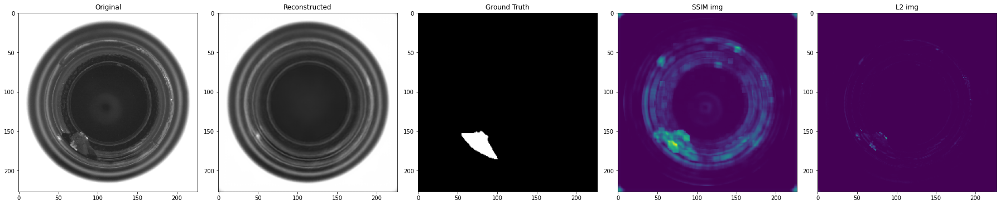

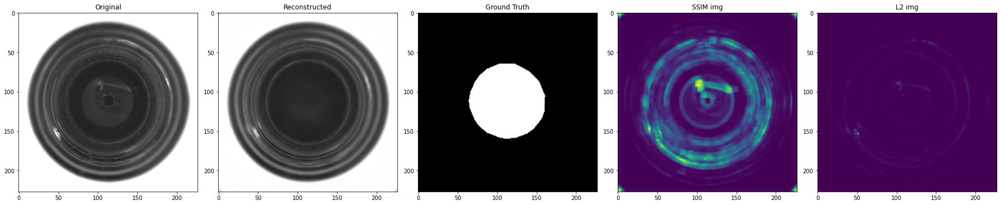

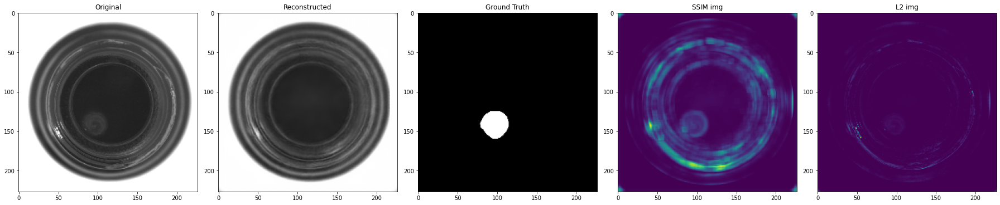

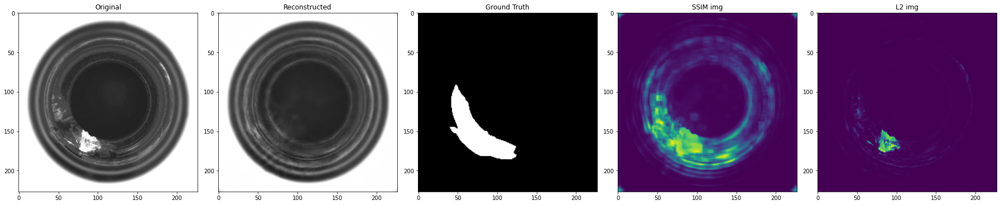

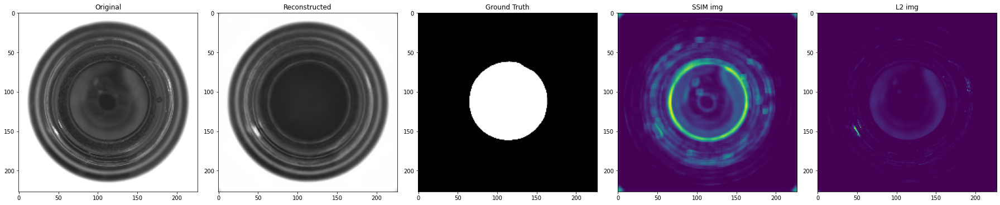

...

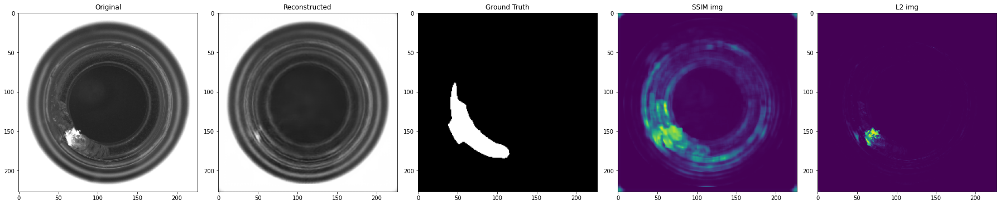

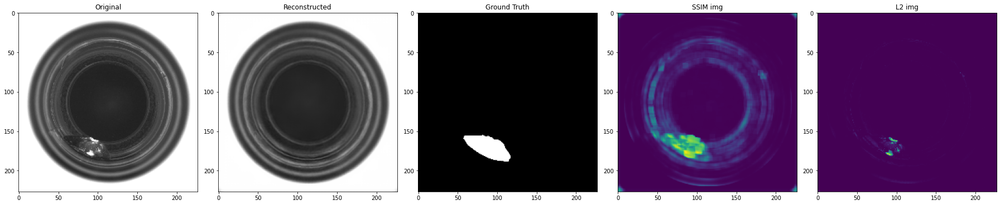

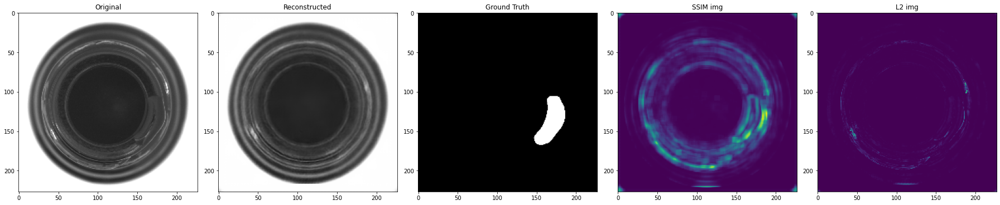

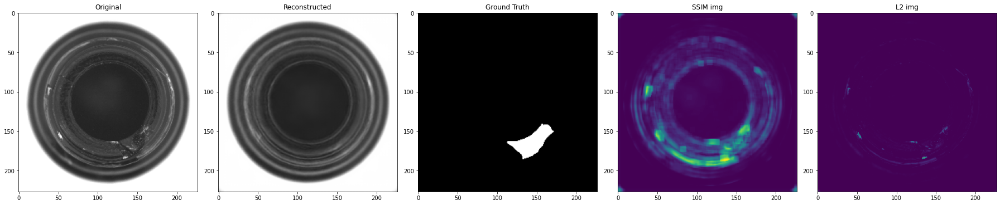

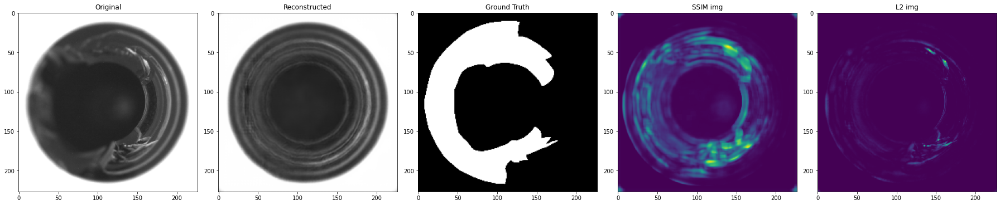

In [ ]:
bad_test_l2_scores = []
bad_test_ssim_scores = []

# Loop over anomalous testing set
for i in range(len(y_bad_test)):
  original = y_bad_test[i]
  reconstructed = preds_test_bad[i]

  ssim_score, ssim_diff = generate_score_and_ground_truth_ssim(original, reconstructed)
  l2_score, l2_diff = generate_score_and_ground_truth_l2(original, reconstructed)

  bad_test_ssim_scores.append(ssim_score)
  bad_test_l2_scores.append(l2_score)

  compare_img_and_ground_truth(original, reconstructed, ssim_diff, l2_diff, ground_truth_test[i])

**Testing Set (Non-Anomalous)**

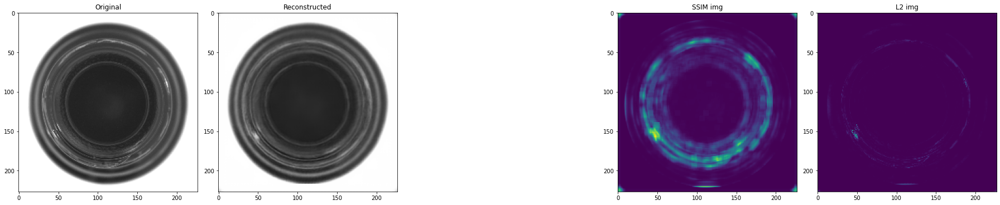

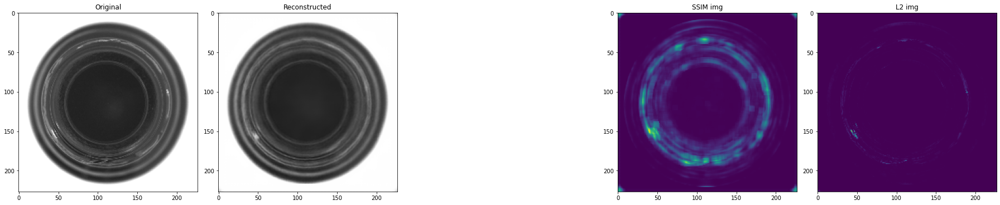

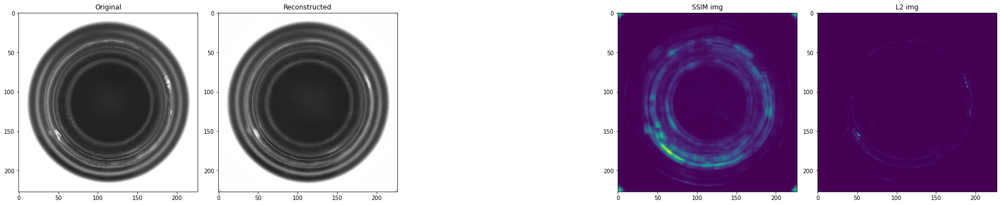

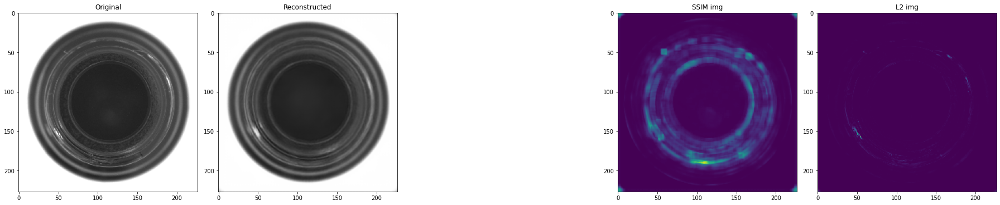

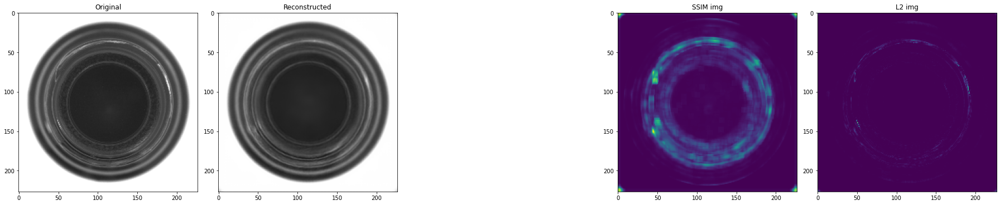

...

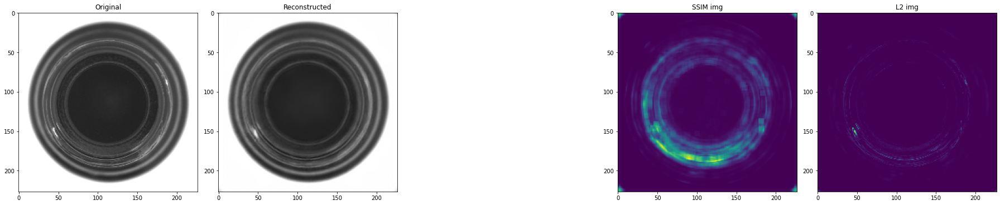

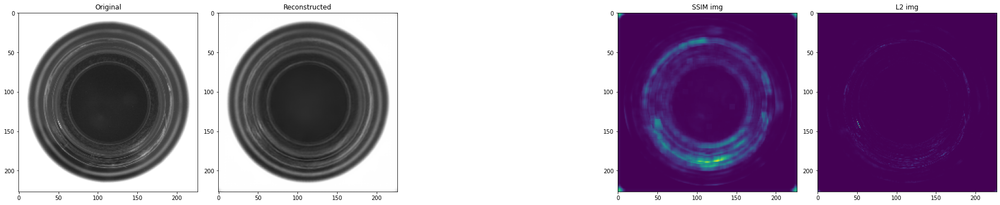

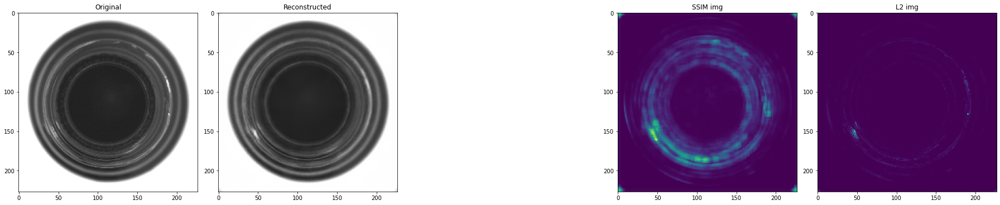

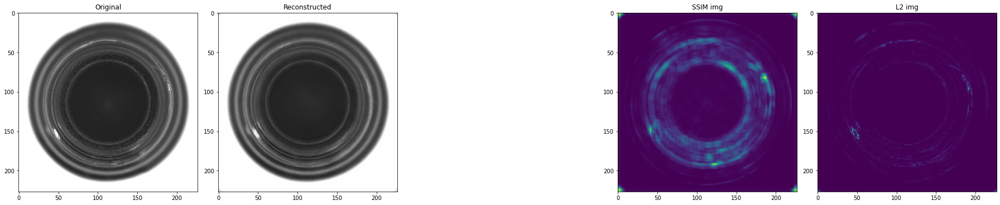

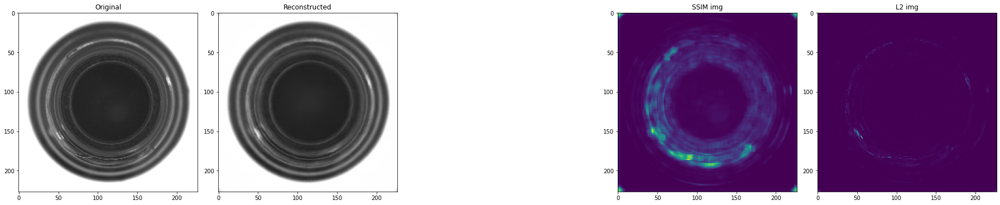

In [ ]:
good_test_l2_scores = []
good_test_ssim_scores = []

# Loop over non-anomalous testing set
for i in range(len(y_good_test)):
  original = y_good_test[i]
  reconstructed = preds_test_good[i]

  ssim_score, ssim_diff = generate_score_and_ground_truth_ssim(original, reconstructed)
  l2_score, l2_diff = generate_score_and_ground_truth_l2(original, reconstructed)

  good_test_ssim_scores.append(ssim_score)
  good_test_l2_scores.append(l2_score)

  compare_img_and_ground_truth(original, reconstructed, ssim_diff, l2_diff, None)

In [ ]:
good_test_l2_scores_norm, bad_test_l2_scores_norm = normalize(good_test_l2_scores, bad_test_l2_scores)
good_test_ssim_scores_norm, bad_test_ssim_scores_norm = normalize(good_test_ssim_scores, bad_test_ssim_scores)

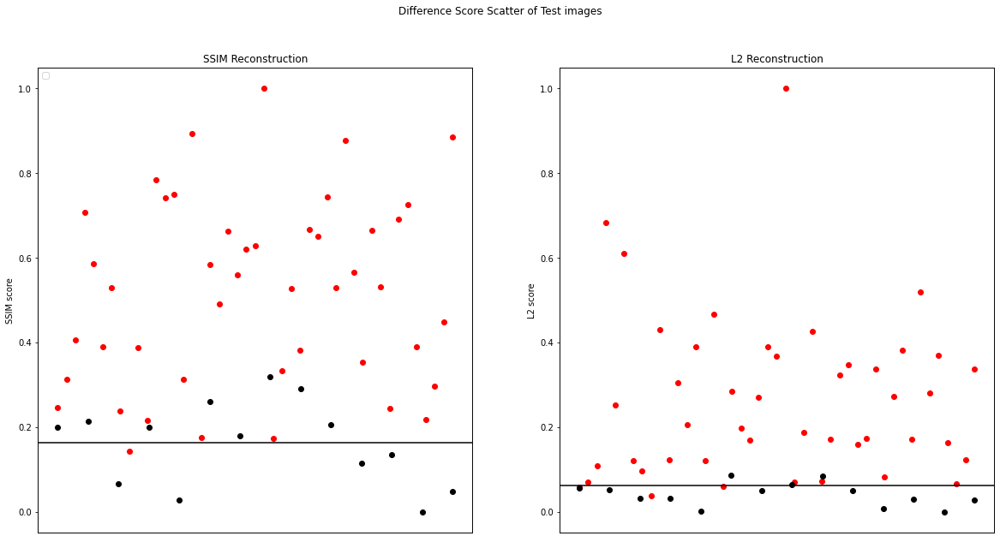

In [ ]:
fig_test, ax_test= plt.subplots(1, 2, figsize=(20, 10))
fig_test.suptitle('Difference Score Scatter of Test images')

ax_test[0].set_title("SSIM Reconstruction")
ax_test[0].set_ylabel('SSIM score')
ax_test[0].legend(['Train loss', 'Val loss'], loc='upper left')
ax_test[0].scatter(range(1,len(bad_test_ssim_scores_norm) + 1), bad_test_ssim_scores_norm, c='red')
ax_test0 = ax_test[0].twiny()
ax_test0.scatter(range(1,len(good_test_ssim_scores_norm) + 1), good_test_ssim_scores_norm, c='black')
ax_test[0].axhline(y=ssim_threshold, color='black', linestyle='-')
ax_test[0].axes.get_xaxis().set_visible(False)
ax_test0.axes.get_xaxis().set_visible(False)

ax_test[1].set_title("L2 Reconstruction")
ax_test[1].set_ylabel('L2 score')
ax_test[1].scatter(range(1, len(bad_test_l2_scores_norm) + 1), bad_test_l2_scores_norm, c='red')
ax_test1 = ax_test[1].twiny()
ax_test1.scatter(range(1, len(good_test_l2_scores_norm) + 1), good_test_l2_scores_norm, c='black')
ax_test[1].axhline(y=l2_threshold, color='black', linestyle='-')
ax_test[1].axes.get_xaxis().set_visible(False)
ax_test1.axes.get_xaxis().set_visible(False)

## F-Score

In [ ]:
# Concatenate results of good and bad test if they are under SSIM threshold
ssim_pred = np.concatenate(((good_test_ssim_scores_norm < ssim_threshold), (bad_test_ssim_scores_norm  < ssim_threshold))) * 1
ssim_true = np.concatenate((np.ones_like(good_test_ssim_scores_norm, dtype=int), np.zeros_like(bad_test_ssim_scores_norm, dtype=int)))

# Concatenate results of good and bad test if they are under L2 threshold
l2_pred = np.concatenate(((good_test_l2_scores_norm < l2_threshold), (bad_test_l2_scores_norm  < l2_threshold))) * 1
l2_true = np.concatenate((np.ones_like(good_test_l2_scores_norm, dtype=int),np.zeros_like(bad_test_l2_scores_norm, dtype=int)))

# F-Score take as input true values and predicted value and return as output a value between 0 and 1
print("SSIM F-Score:\t", f1_score(ssim_true, ssim_pred))
print("L2 F-Score:\t", f1_score(l2_true, l2_pred))

SSIM F-Score:	 0.5714285714285714
L2 F-Score:	 0.7857142857142857
